In [1]:
%pip install decorator==5.0.9

import imp
import numpy as np
import pandas as pd
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity
import matplotlib.pyplot as plt
import networkx as nx

Note: you may need to restart the kernel to use updated packages.


In [2]:
# importing local modules

import sys
sys.path.append('../src/')

import text_cleanup.text_cleanup as thesisCleanUp
import preprocessing.text_preprocessing as thesisTextPreprocessing
import data.reader as thesisDataReader
import utils.utils as thesisUtils

imp.reload(thesisCleanUp)
imp.reload(thesisTextPreprocessing)
imp.reload(thesisDataReader)
imp.reload(thesisUtils)

<module 'utils.utils' from '../src/utils/utils.py'>

In [3]:
a_zwickau_text = thesisDataReader.read_a_zwickau()
b_london_text = thesisDataReader.read_b_london()

In [4]:
a_zwickau_corpus = thesisCleanUp.create_corpus_by_line(thesisCleanUp.jvtext(a_zwickau_text))
b_london_corpus = thesisCleanUp.create_corpus_by_line(thesisCleanUp.jvtext(b_london_text))

In [5]:
a_zwickau_corpus = list(map(lambda x: x.replace(' ', ''), a_zwickau_corpus))
b_london_corpus = list(map(lambda x: x.replace(' ', ''), b_london_corpus))

In [6]:
def get_features(corpus):
    vectorizer = TfidfVectorizer(ngram_range=(5,5), analyzer='char')
    sparse_matrix = vectorizer.fit_transform(corpus)
    doc_term_matrix = sparse_matrix.todense()
    df = pd.DataFrame(doc_term_matrix, columns=vectorizer.get_feature_names())
    return df

In [7]:
a_zwickau_df = get_features(a_zwickau_corpus)
a_zwickau_similarities = cosine_similarity(a_zwickau_df, a_zwickau_df)

b_london_df = get_features(b_london_corpus)
b_london_similarities = cosine_similarity(b_london_df, b_london_df)

In [8]:
a_zwickau_df

,(112r,(112u,(113r,(113u,(114r,(114u,(115r,(115u,(116r,(116u,...,zoele,zoret,zotum,zotus,zradi,zrael,zrahe,zucur,zurio,½leuc
0,0.0,0.212456,0.0000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.000000,0.0000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.000000,0.0641,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.000000,0.0000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.000000,0.0000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
317,0.0,0.000000,0.0000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
318,0.0,0.000000,0.0000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
319,0.0,0.000000,0.0000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
320,0.0,0.000000,0.0000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [9]:
def show_similarities_data(similarities):
    for index, value in enumerate(similarities):
        max_indices = thesisUtils.get_n_indexes_of_max_values(value, 6)
        print('___ max similariry for paragraph: {} ___'.format(index))
        for i in max_indices:
            print('index: [{}] value: {}'.format(i, similarities[index][i]))
        print('average: {}'.format(np.average(value)))

        unique, counts = np.unique(value, return_counts=True)
        unique_dictionary = dict(zip(unique, counts))
        print('0 similarities: {}'.format(unique_dictionary.get(0.0)))

        print()

In [10]:
show_similarities_data(a_zwickau_similarities)

___ max similariry for paragraph: 0 ___
index: [6] value: 0.038063738341370223
index: [46] value: 0.050860603670104
index: [19] value: 0.05334976301496544
index: [49] value: 0.060177609110644396
index: [321] value: 0.11405546254957834
index: [0] value: 1.0
average: 0.007086609281266458
0 similarities: 212

___ max similariry for paragraph: 1 ___
index: [168] value: 0.046935990672381876
index: [283] value: 0.04819627331806421
index: [5] value: 0.049461447201640064
index: [196] value: 0.05283032967823223
index: [6] value: 0.06495072558101611
index: [1] value: 0.9999999999999989
average: 0.017836626863205116
0 similarities: 10

___ max similariry for paragraph: 2 ___
index: [301] value: 0.03813677202648591
index: [5] value: 0.04277100506109251
index: [214] value: 0.04325501273322631
index: [212] value: 0.057842522552991
index: [211] value: 0.062290897173816064
index: [2] value: 0.9999999999999999
average: 0.014315826728963818
0 similarities: 20

___ max similariry for paragraph: 3 ___
ind

index: [227] value: 0.10162123202504098
index: [196] value: 0.16354767307716372
index: [195] value: 1.0000000000000002
average: 0.016506942375224428
0 similarities: 35

___ max similariry for paragraph: 196 ___
index: [184] value: 0.06755458980002962
index: [229] value: 0.08811910692099056
index: [227] value: 0.11956606632281028
index: [194] value: 0.1237443039700206
index: [195] value: 0.16354767307716372
index: [196] value: 0.9999999999999997
average: 0.021138054971348855
0 similarities: 8

___ max similariry for paragraph: 197 ___
index: [185] value: 0.05182379794275969
index: [199] value: 0.06919283099063918
index: [184] value: 0.07327253279276957
index: [172] value: 0.08237826847745319
index: [213] value: 0.09144109386532107
index: [197] value: 0.9999999999999991
average: 0.017929522814748494
0 similarities: 16

___ max similariry for paragraph: 198 ___
index: [197] value: 0.03251716128181375
index: [131] value: 0.03406643891024868
index: [26] value: 0.03438065971585179
index: [19

In [11]:
show_similarities_data(b_london_similarities)

___ max similariry for paragraph: 0 ___
index: [209] value: 0.05091841092615105
index: [262] value: 0.05583491935827001
index: [19] value: 0.062116488916674054
index: [21] value: 0.06274458051240035
index: [266] value: 0.06559435058399238
index: [0] value: 0.9999999999999998
average: 0.007259217695699882
0 similarities: 188

___ max similariry for paragraph: 1 ___
index: [311] value: 0.041719064511612634
index: [205] value: 0.042172086759310716
index: [275] value: 0.044980018636492244
index: [187] value: 0.05222846108024115
index: [225] value: 0.05881997495798567
index: [1] value: 1.0000000000000007
average: 0.018851763752151928
0 similarities: 2

___ max similariry for paragraph: 2 ___
index: [299] value: 0.03906428188094974
index: [220] value: 0.039431482365729506
index: [5] value: 0.04184061656425788
index: [281] value: 0.04209819103954527
index: [218] value: 0.046348682965546804
index: [2] value: 0.9999999999999999
average: 0.01543226769694097
0 similarities: 10

___ max similariry

index: [94] value: 0.07124616652705067
index: [205] value: 0.07737637777955077
index: [47] value: 0.08133212222116887
index: [98] value: 0.08755231251472965
index: [83] value: 0.9999999999999971
average: 0.031135088803901555
0 similarities: 1

___ max similariry for paragraph: 84 ___
index: [96] value: 0.06502005315925882
index: [83] value: 0.0660299789029552
index: [87] value: 0.067296297609737
index: [77] value: 0.0681958226490716
index: [91] value: 0.11235607581887777
index: [84] value: 0.9999999999999997
average: 0.019434971431212363
0 similarities: 11

___ max similariry for paragraph: 85 ___
index: [98] value: 0.0714336574622756
index: [232] value: 0.09717804715001449
index: [91] value: 0.09910388711627942
index: [86] value: 0.1055193332976935
index: [74] value: 0.1109637005558278
index: [85] value: 0.9999999999999999
average: 0.023523570767700463
0 similarities: 5

___ max similariry for paragraph: 86 ___
index: [77] value: 0.04481606336557094
index: [6] value: 0.051501410405508

index: [195] value: 0.08491831030494286
index: [222] value: 0.11135997160387473
index: [188] value: 0.9999999999999983
average: 0.02038647429558769
0 similarities: 6

___ max similariry for paragraph: 189 ___
index: [60] value: 0.03600600071049848
index: [205] value: 0.03658715614607711
index: [85] value: 0.037421623536695994
index: [190] value: 0.03853215140849751
index: [176] value: 0.042780406250556666
index: [189] value: 0.9999999999999996
average: 0.014677684964995847
0 similarities: 9

___ max similariry for paragraph: 190 ___
index: [162] value: 0.05783723722429647
index: [220] value: 0.06063592874328772
index: [164] value: 0.06664371222384154
index: [191] value: 0.07421315258696146
index: [188] value: 0.07714274014633415
index: [190] value: 1.0000000000000002
average: 0.020341642065944084
0 similarities: 5

___ max similariry for paragraph: 191 ___
index: [163] value: 0.06961914520108901
index: [166] value: 0.07360120172302942
index: [190] value: 0.07421315258696146
index: [164

index: [293] value: 1.0
average: 0.025144474618631934
0 similarities: 3

___ max similariry for paragraph: 294 ___
index: [314] value: 0.05282747151785573
index: [298] value: 0.05409693806619463
index: [303] value: 0.057226579712493446
index: [291] value: 0.12159936630822278
index: [290] value: 0.16075486803862643
index: [294] value: 1.0000000000000007
average: 0.018338032881916575
0 similarities: 9

___ max similariry for paragraph: 295 ___
index: [275] value: 0.0632075799650496
index: [296] value: 0.07731924358030551
index: [291] value: 0.07886856349438129
index: [293] value: 0.08373466199063298
index: [154] value: 0.17176638621220988
index: [295] value: 1.0000000000000044
average: 0.02546480678401171
0 similarities: 1

___ max similariry for paragraph: 296 ___
index: [293] value: 0.04596217553935828
index: [298] value: 0.04647802405610039
index: [275] value: 0.05393776841471375
index: [154] value: 0.07685223787482721
index: [295] value: 0.07731924358030551
index: [296] value: 1.0000

In [12]:
def get_max_similarity_per_p(similarities):
    res = []
    for index, value in enumerate(similarities):
        max_indices = thesisUtils.get_n_indexes_of_max_values(value, 6)
        max_indices_without_self = max_indices[:-1]
        max_similarity = value[max_indices_without_self[-1]]
        res.append(max_similarity)
    return res

In [13]:
a_zwickau_max_similarity_per_p = get_max_similarity_per_p(a_zwickau_similarities)
b_london_max_similarity_per_p = get_max_similarity_per_p(b_london_similarities)


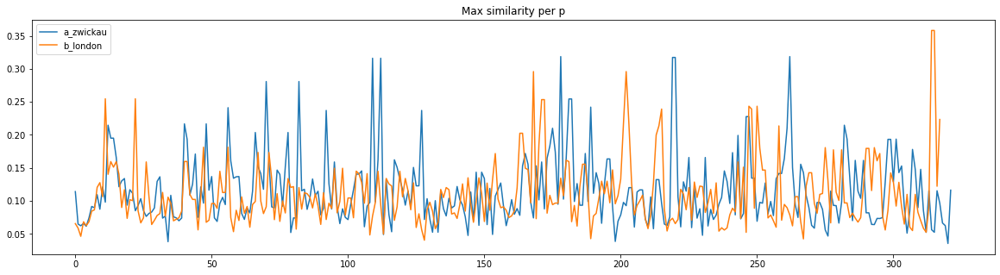

In [14]:
%matplotlib inline
fig, ax = plt.subplots(figsize=(20, 5))
ax.plot(a_zwickau_max_similarity_per_p, label="a_zwickau")
ax.plot(b_london_max_similarity_per_p, label="b_london")
ax.legend()
plt.title('Max similarity per p')
plt.show()

In [15]:
def cross_version_similarity(version_1_corpus, version_2_corpus):
    res = []
    for i, p in enumerate(version_1_corpus):
        temp_corpus = [p] + version_2_corpus
        df_features = get_features(temp_corpus)
        temp_similarities = cosine_similarity(df_features, df_features)
        res.append(temp_similarities[0])
    return res

In [16]:
a_zwickau_b_london_similarities = cross_version_similarity(a_zwickau_corpus, b_london_corpus)
b_london_a_zwickau_similarities = cross_version_similarity(b_london_corpus, a_zwickau_corpus)


In [17]:
show_similarities_data(a_zwickau_b_london_similarities)

___ max similariry for paragraph: 0 ___
index: [154] value: 0.04298687753734604
index: [318] value: 0.04538775501770563
index: [21] value: 0.06342255535317637
index: [20] value: 0.07820520153395383
index: [9] value: 0.11985523934420356
index: [0] value: 1.0000000000000002
average: 0.007584376180880933
0 similarities: 202

___ max similariry for paragraph: 1 ___
index: [7] value: 0.044127101737562645
index: [188] value: 0.045899980077320636
index: [226] value: 0.04879618225072957
index: [276] value: 0.04971036133373715
index: [2] value: 0.7490411274869653
index: [0] value: 0.9999999999999996
average: 0.020869633287831566
0 similarities: 2

___ max similariry for paragraph: 2 ___
index: [300] value: 0.03800420361323096
index: [282] value: 0.04013896907680871
index: [6] value: 0.04391912160168843
index: [219] value: 0.045772093492950416
index: [3] value: 0.8434052712117132
index: [0] value: 1.000000000000002
average: 0.017269755099834017
0 similarities: 12

___ max similariry for paragrap

index: [234] value: 0.05541686389623351
index: [276] value: 0.07022359112362996
index: [236] value: 0.0904697804852682
index: [235] value: 0.34390154875002665
index: [0] value: 0.9999999999999998
average: 0.019319813136407883
0 similarities: 6

___ max similariry for paragraph: 229 ___
index: [125] value: 0.06708764043883116
index: [187] value: 0.07534252064418191
index: [234] value: 0.09103911444355897
index: [188] value: 0.09880258464451402
index: [236] value: 0.42601269409254594
index: [0] value: 0.9999999999999998
average: 0.018951066829447593
0 similarities: 11

___ max similariry for paragraph: 230 ___
index: [265] value: 0.04015559456965772
index: [6] value: 0.04430764954269225
index: [266] value: 0.046683164261973005
index: [261] value: 0.05126182607978657
index: [232] value: 0.19324031339955244
index: [0] value: 1.0
average: 0.01453166838322547
0 similarities: 12

___ max similariry for paragraph: 231 ___
index: [245] value: 0.0454584633593382
index: [97] value: 0.051223320564

In [18]:
show_similarities_data(b_london_a_zwickau_similarities)

___ max similariry for paragraph: 0 ___
index: [21] value: 0.044185624569579585
index: [138] value: 0.047106232229567356
index: [281] value: 0.04902244161085676
index: [275] value: 0.06753199496578619
index: [219] value: 0.06991724961358073
index: [0] value: 1.0000000000000002
average: 0.007332651020419145
0 similarities: 196

___ max similariry for paragraph: 1 ___
index: [169] value: 0.04475605680925787
index: [6] value: 0.04648152251219597
index: [197] value: 0.04958445379663443
index: [7] value: 0.056245651635662655
index: [2] value: 0.7488122541272051
index: [0] value: 1.0000000000000022
average: 0.019340567987993572
0 similarities: 10

___ max similariry for paragraph: 2 ___
index: [282] value: 0.042222594113195226
index: [215] value: 0.04284677794667251
index: [213] value: 0.06158670441676244
index: [212] value: 0.06617321134490561
index: [3] value: 0.8456868469103954
index: [0] value: 1.0000000000000007
average: 0.017698511655538512
0 similarities: 20

___ max similariry for pa

index: [47] value: 0.04999035890594968
index: [81] value: 0.05118658819920444
index: [85] value: 0.057877140002913705
index: [82] value: 0.5841150001843409
index: [0] value: 1.0000000000000004
average: 0.019846883216650024
0 similarities: 11

___ max similariry for paragraph: 71 ___
index: [66] value: 0.10117679367969956
index: [88] value: 0.12314484681848792
index: [57] value: 0.21451978188375592
index: [71] value: 0.3344418217060311
index: [83] value: 0.6655581112187189
index: [0] value: 0.9999999999999983
average: 0.03323659156481053
0 similarities: None

___ max similariry for paragraph: 72 ___
index: [61] value: 0.06777167198959487
index: [8] value: 0.06812585773663617
index: [79] value: 0.08941206962630975
index: [72] value: 0.09972228511691698
index: [58] value: 0.19072512951703394
index: [0] value: 1.0000000000000007
average: 0.020640547240259707
0 similarities: 9

___ max similariry for paragraph: 73 ___
index: [70] value: 0.06384925617386979
index: [76] value: 0.0706960841848

index: [216] value: 0.6473637948341954
index: [0] value: 1.000000000000003
average: 0.021568552895686804
0 similarities: 8

___ max similariry for paragraph: 225 ___
index: [302] value: 0.07072825911629967
index: [215] value: 0.07133761153858692
index: [214] value: 0.08935576025587459
index: [195] value: 0.11372251109641279
index: [217] value: 0.4494211039477327
index: [0] value: 1.0000000000000013
average: 0.024001225322849908
0 similarities: 10

___ max similariry for paragraph: 226 ___
index: [36] value: 0.04493525906208869
index: [60] value: 0.04640169929342212
index: [307] value: 0.04954284323679709
index: [275] value: 0.06555146637139325
index: [219] value: 0.3241100315713483
index: [0] value: 1.0000000000000004
average: 0.01975541854020344
0 similarities: 4

___ max similariry for paragraph: 227 ___
index: [212] value: 0.07111083796709139
index: [161] value: 0.08051313614234745
index: [222] value: 0.08249826333966495
index: [221] value: 0.10794423129366298
index: [220] value: 0.

In [19]:
a_zwickau_b_london_max_similarity_per_p = get_max_similarity_per_p(a_zwickau_b_london_similarities)
b_london_a_zwickau_max_similarity_per_p = get_max_similarity_per_p(b_london_a_zwickau_similarities)

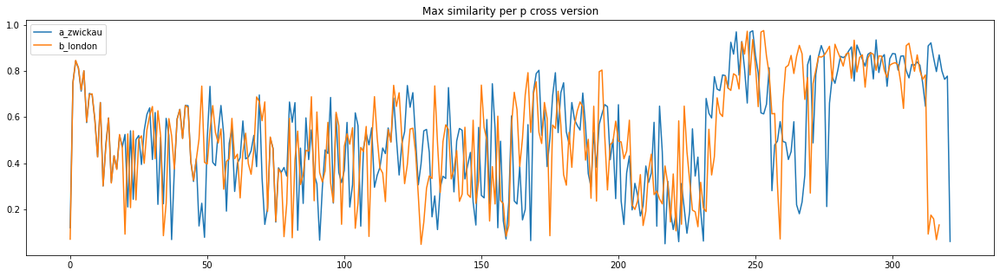

In [20]:
fig, ax = plt.subplots(figsize=(20, 5))
ax.plot(a_zwickau_b_london_max_similarity_per_p, label="a_zwickau")
ax.plot(b_london_a_zwickau_max_similarity_per_p, label="b_london")
ax.legend()
plt.title('Max similarity per p cross version')
plt.show()

In [21]:
def create_G_of_similaritis(similarities):
    G = nx.Graph()
    for index, value in enumerate(similarities):
        max_indices = thesisUtils.get_n_indexes_of_max_values(value, 6)
        max_indices_without_self = max_indices[:-1]
        G.add_node(index) # node himself
        for n in max_indices_without_self:
            G.add_node(n)
            weight = similarities[index][n]
            G.add_weighted_edges_from([(index, n, weight)])
    return G

In [22]:
def show_G(G):
    %matplotlib notebook

    fig = plt.figure(figsize=(10, 10))
    fig.canvas.manager.full_screen_toggle()

    pos=nx.spring_layout(G)
    nx.draw(
        G, 
        pos,
        with_labels=True, 
    )
    fig.show()

In [23]:
a_zwickau_G = create_G_of_similaritis(a_zwickau_similarities)
b_london_G = create_G_of_similaritis(b_london_similarities)

In [24]:
print(len(list(nx.connected_components(a_zwickau_G))))
print(len(list(nx.connected_components(b_london_G))))

1
1


In [25]:
a_zwickau_sorted_degree = sorted(a_zwickau_G.degree, key=lambda x: x[1], reverse=True)
print(a_zwickau_sorted_degree)

[(169, 25), (87, 25), (283, 24), (301, 20), (299, 20), (282, 18), (152, 15), (105, 15), (184, 15), (262, 15), (280, 14), (54, 14), (175, 14), (213, 13), (6, 12), (59, 12), (12, 12), (70, 12), (246, 12), (15, 11), (21, 11), (82, 11), (23, 11), (281, 11), (95, 11), (86, 11), (223, 11), (182, 11), (174, 11), (173, 11), (214, 10), (71, 10), (163, 10), (104, 10), (138, 10), (225, 10), (192, 10), (279, 9), (14, 9), (13, 9), (18, 9), (24, 9), (123, 9), (200, 9), (88, 9), (297, 9), (84, 9), (98, 9), (165, 9), (236, 9), (188, 9), (194, 9), (19, 8), (5, 8), (196, 8), (211, 8), (185, 8), (287, 8), (10, 8), (42, 8), (224, 8), (171, 8), (22, 8), (35, 8), (36, 8), (237, 8), (91, 8), (53, 8), (124, 8), (255, 8), (101, 8), (56, 8), (75, 8), (76, 8), (74, 8), (247, 8), (146, 8), (120, 8), (89, 8), (240, 8), (132, 8), (161, 8), (265, 8), (258, 8), (219, 8), (141, 8), (160, 8), (176, 8), (264, 8), (215, 8), (290, 8), (46, 7), (183, 7), (318, 7), (20, 7), (17, 7), (239, 7), (16, 7), (149, 7), (30, 7), (25

In [26]:
b_london_sorted_degree = sorted(b_london_G.degree, key=lambda x: x[1], reverse=True)
print(b_london_sorted_degree)

[(275, 24), (164, 22), (71, 19), (162, 19), (163, 19), (314, 18), (192, 17), (98, 15), (293, 15), (235, 14), (27, 13), (80, 13), (317, 13), (82, 13), (25, 13), (315, 13), (104, 13), (172, 13), (153, 12), (274, 12), (202, 12), (208, 12), (205, 11), (176, 11), (37, 11), (151, 11), (20, 11), (174, 11), (130, 11), (67, 11), (97, 11), (134, 11), (250, 11), (272, 10), (197, 10), (56, 10), (291, 10), (85, 10), (289, 10), (55, 10), (51, 10), (233, 10), (77, 10), (212, 10), (118, 10), (222, 10), (129, 10), (313, 10), (281, 9), (271, 9), (13, 9), (46, 9), (22, 9), (144, 9), (158, 9), (102, 9), (40, 9), (178, 9), (261, 9), (228, 9), (74, 9), (292, 9), (230, 9), (227, 9), (106, 9), (101, 9), (167, 9), (214, 9), (282, 9), (187, 8), (299, 8), (115, 8), (14, 8), (15, 8), (103, 8), (23, 8), (42, 8), (36, 8), (47, 8), (59, 8), (31, 8), (165, 8), (73, 8), (186, 8), (123, 8), (95, 8), (69, 8), (231, 8), (269, 8), (166, 8), (298, 8), (185, 8), (199, 8), (204, 8), (201, 8), (203, 8), (301, 8), (209, 7), (2

In [27]:
a_zwickau_strongly_connected_nodes = [(node, degree) for node, degree in a_zwickau_sorted_degree if degree >= 10]
print(len(a_zwickau_strongly_connected_nodes))
print(a_zwickau_strongly_connected_nodes)

37
[(169, 25), (87, 25), (283, 24), (301, 20), (299, 20), (282, 18), (152, 15), (105, 15), (184, 15), (262, 15), (280, 14), (54, 14), (175, 14), (213, 13), (6, 12), (59, 12), (12, 12), (70, 12), (246, 12), (15, 11), (21, 11), (82, 11), (23, 11), (281, 11), (95, 11), (86, 11), (223, 11), (182, 11), (174, 11), (173, 11), (214, 10), (71, 10), (163, 10), (104, 10), (138, 10), (225, 10), (192, 10)]


In [28]:
b_london_strongly_connected_nodes = [(node, degree) for node, degree in b_london_sorted_degree if degree >= 10]
print(len(b_london_strongly_connected_nodes))
print(b_london_strongly_connected_nodes)

48
[(275, 24), (164, 22), (71, 19), (162, 19), (163, 19), (314, 18), (192, 17), (98, 15), (293, 15), (235, 14), (27, 13), (80, 13), (317, 13), (82, 13), (25, 13), (315, 13), (104, 13), (172, 13), (153, 12), (274, 12), (202, 12), (208, 12), (205, 11), (176, 11), (37, 11), (151, 11), (20, 11), (174, 11), (130, 11), (67, 11), (97, 11), (134, 11), (250, 11), (272, 10), (197, 10), (56, 10), (291, 10), (85, 10), (289, 10), (55, 10), (51, 10), (233, 10), (77, 10), (212, 10), (118, 10), (222, 10), (129, 10), (313, 10)]


<IPython.core.display.Javascript object>


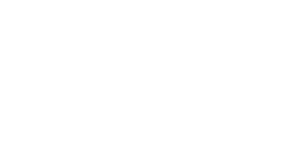

In [29]:
show_G(a_zwickau_G)

<IPython.core.display.Javascript object>


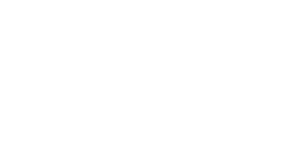

In [30]:
show_G(b_london_G)

In [31]:
%matplotlib inline
fig, axes = plt.subplots(318, 1, figsize=(20,900))
a_zwickau_similarities_df = pd.DataFrame(a_zwickau_similarities)
b_london_similarities_df = pd.DataFrame(b_london_similarities)

for i, ax in enumerate(axes.ravel()):
    ax.set_title(f'paragraph {i}')
    
    if i in list(a_zwickau_similarities_df.index):
        y_1 = a_zwickau_similarities_df.iloc[i, :]
        ax.plot(y_1, color='orange', label='a_zwickau')
    
    if i in list(b_london_similarities_df.index):
        y_2 = b_london_similarities_df.iloc[i, :]
        ax.plot(y_2, label='b_london')
        
    ax.grid()
    ax.set_ylim([0,1])
    ax.legend()

plt.show()

In [32]:
%matplotlib inline
fig, axes = plt.subplots(318, 1, figsize=(20,900))
a_zwickau_similarities_df = pd.DataFrame(a_zwickau_b_london_similarities)
b_london_similarities_df = pd.DataFrame(b_london_a_zwickau_similarities)

for i, ax in enumerate(axes.ravel()):
    ax.set_title(f'paragraph {i}')
    
    if i in list(a_zwickau_similarities_df.index):
        y_1 = a_zwickau_similarities_df.iloc[i,:]
        ax.plot(y_1, color='orange', label='a_zwickau')
    
    if i in list(b_london_similarities_df.index):
        y_2 = b_london_similarities_df.iloc[i,:]
        ax.plot(y_2, label='b_london')
        
    ax.grid()
    ax.set_ylim([0,1])
    ax.legend()

plt.show()